# $\mathrm{O_3}$

In [1]:
using Plots, MLPlotRecipes 
using HDF5 
using Tables
using MLJ, MLJGaussianProcesses

In [2]:
h5_path = "../../data/photolysis_data.h5" 
isfile(h5_path)

true

In [3]:
h5 = h5open(h5_path, "r");

In [4]:
cross_sections = h5["cross-sections"]

"O3" ∈ keys(cross_sections)

O3_data = cross_sections["O3"]

📂 HDF5.Group: /cross-sections/O3 (file: ../../data/photolysis_data.h5)
├─ 🏷️ T1_units
├─ 🏷️ T2_units
├─ 🏷️ category
├─ 🏷️ formula
├─ 🏷️ Δσ_units
├─ 🏷️ λ_units
├─ 🏷️ σ_units
├─ 🔢 T1
├─ 🔢 T2
├─ 🔢 source_idx
├─ 📂 source_info
│  ├─ 📂 1
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 10
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 100
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 101
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 102
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 103
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 104
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ download_url
│  ├─ 📂 105
│  │  ├─ 🏷️ author(year)
│  │  ├─ 🏷️ comments
│  │  ├─ 🏷️ doi
│  │  └─ 🏷️ do

In [5]:
λs = read(O3_data, "λ")
σs = read(O3_data, "σ")
T1s = read(O3_data, "T1")
T2s = read(O3_data, "T2")
source_idx = read(O3_data, "source_idx")



T_units = read_attribute(O3_data, "T1_units")
category= read_attribute(O3_data, "category")
formula= read_attribute(O3_data, "formula")
λ_units = read_attribute(O3_data, "λ_units")
σ_units = read_attribute(O3_data, "σ_units")

println(T_units)
println(category)
println(formula)
println(λ_units)
println(σ_units)

close(h5)

K
Ozone
O3
nm
cm^2


In [6]:
println(size(λs))
println(size(T1s))
println(size(σs))

(2591145,)
(249,)
(2591145,)


In [7]:
using DataFrames

In [8]:
function generate_data_table(λs, σs, T1s, T2s, source_idx; σ_lb=1e-25, σ_ub=1.0, T_lb=290.0, T_ub=305.0, λ_lb=200.0, λ_ub=1100.0)
    Tout = [T1s[source_idx[i]] for i ∈ 1:size(source_idx, 1)]
    
    # we want T2 to be NaN
    idx = [ i for i  ∈ 1:size(source_idx,1) if isnan(T2s[source_idx[i]])]
    λout = λs[idx]
    σout = σs[idx]
    Tout = Tout[idx]
    source_out = source_idx[idx]

    # we want T between T_lb and T_ub
    idx2 = [i for i ∈ 1:size(λout,1) if (T_lb ≤ Tout[i] && Tout[i] ≤ T_ub)]
    λout = λout[idx2]
    σout = σout[idx2]
    Tout = Tout[idx2]
    source_out = source_out[idx2]

    # we want σ to not be NaN and greater than 0.
    idx3 = [i for i ∈ 1:size(σout,1) if !isnan(σout[i]) && (σout[i] > σ_lb) && (σout[i] ≤ σ_ub)]
    λout = λout[idx3]
    σout = σout[idx3]
    Tout = Tout[idx3]
    source_out = source_out[idx3]

    # we want λ to be between λ_lb and λ_ub
    idx4 = [i for i ∈ 1:size(λout,1) if (λ_lb ≤ λout[i] && λout[i] ≤ λ_ub)]
    λout = λout[idx4]
    σout = σout[idx4]
    Tout = Tout[idx4]
    source_out = source_out[idx4]
   
    # idxs = [i for i ∈ 1:size(source_idx, 1) if (T_lb < Temps[i] && Temps[i] < T_ub) && (!isnan(σs[i])) && (σs[i] ≥ 0.0) && (λ_lb ≤ λs[i] && λs[i] ≤ λ_ub) && isnan(T2s[source_idx[i]])]

    # 5. Create table with data containing the good values
    #data_table = Tables.columntable((; λ=λout, σ=σout, T=Tout, source_id=source_out))
    df =  DataFrame(λ=λout, σ=σout, T=Tout, source_id=source_out)
    return df
end


df = generate_data_table(λs, σs, T1s, T2s, source_idx)
println(nrow(df))
describe(df)

365012


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Real,Float64,Real,Int64,DataType
1,λ,566.604,200.0,541.333,1100.0,0,Float64
2,σ,9.09226e-19,3.4377e-25,8.00578e-22,1.41e-17,0,Float64
3,T,293.785,290.0,293.0,300.0,0,Float64
4,source_id,130.496,1,175.0,249,0,Int64


In [9]:
p = scatter(
    df.λ[1:5:end],
    df.T[1:5:end],
    zcolor=log10.(df.σ[1:5:end]),
    ms=3,
    msw=0, 
    xlabel="λ [$(λ_units)]",
    ylabel="T [$(T_units)]",
    label="data", 
    alpha=0.7, 
    rightmargin=10Plots.mm,
    colorbar_title="log10(σ) [cm²]",
    title="Absorption Cross Section Data for O₃",
)

savefig("O3_log10σ.png")

display(p)

In [10]:
p = scatter(
    df.λ[1:5:end],
    df.T[1:5:end],
    zcolor=df.σ[1:5:end],
    ms=3,
    msw=0, 
    xlabel="λ [$(λ_units)]",
    ylabel="T [$(T_units)]",
    label="data", 
    alpha=0.7, 
    rightmargin=10Plots.mm,
    colorbar_title="σ [cm²]",
    title="Absorption Cross Section Data for O₃",
)

savefig("O3_σ.png")
display(p)

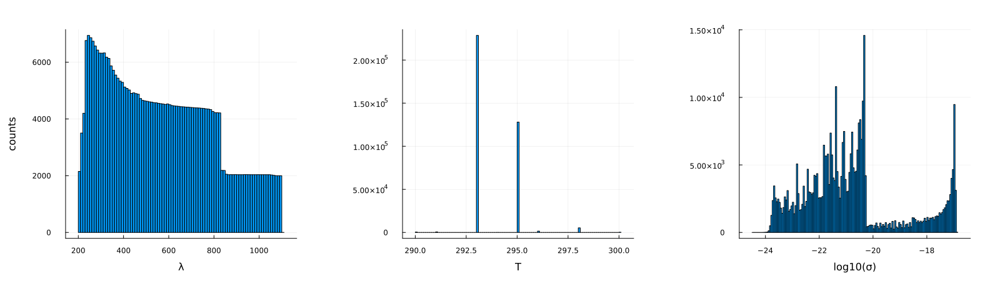

In [27]:
p1 = histogram(df.λ, xlabel="λ", ylabel="counts", label="", margin=10Plots.mm)
p2 = histogram(df.T, xlabel="T", label="", margin=10Plots.mm)
p3 = histogram(log10.(df.σ), xlabel="log10(σ)", label="", margin=10Plots.mm)
#p3 = histogram(df.σ, xlabel="σ", ylabel="counts")

phist = plot(p1, p2, p3, layout=(1,3), size=(1600, 450))
savefig("histograms.png")
display(phist)

We can now thik of this as providing our training data. The goal is to learn a function $f:(\lambda, T) \mapsto \sigma$. Our model of choice will be to use a gaussian process.

First let's split up the data into training and testing pairs. 

::: {.callout-important} 

We should think carefully about how to do this. The most important information is probably in regions where there is rapid changes. We can also examine fitting $\log(\sigma)$ if $\sigma$ alone is to sharply peaked...

:::

In [12]:
n = nrow(df)
train_frac = 0.01

idxs = shuffle(1:n)
ntrain = round(Int, (1.0 - train_frac)*n)

idx_train = idxs[1:ntrain]
idx_test = idxs[ntrain+1:end]


df_train = df[idx_train, :]
df_test = df[idx_test, :]


Row,λ,σ,T,source_id
,Float64,Float64,Float64,Int64
1,668.8,1.73771e-21,293.0,175
2,852.59,1.44575e-22,293.0,176
3,724.0,5.523e-22,295.0,53
4,627.932,3.746e-21,293.0,221
5,234.74,6.18845e-18,293.0,176
6,599.76,5.13058e-21,295.0,48
7,885.13,4.37375e-23,293.0,175
8,408.408,7.938e-23,293.0,221
9,800.28,1.55912e-22,295.0,48


In [13]:
Xtrain = df_train[!, [:λ, :T]]
ytrain = df_train[!, :σ]

Xtest = df_test[!, [:λ, :T]]
ytest = df_test[!, :σ]

3650-element Vector{Float64}:
 1.73771e-21
 1.445749e-22
 5.523e-22
 3.746e-21
 6.188448e-18
 5.13058e-21
 4.37375e-23
 7.938e-23
 1.55912e-22
 1.59597e-18
 7.691088e-23
 1.52178e-22
 1.770092e-22
 ⋮
 4.70862e-23
 4.4885e-21
 4.80926e-23
 7.098132e-22
 4.15931e-22
 1.10054e-22
 2.17106e-21
 8.733981e-24
 1.73649e-18
 1.335722e-23
 1.09734e-17
 3.73944e-24

In [14]:
gpr = GPR()
#mach = machine(gpr, Xtrain, ytrain) |> fit!



GPR(
  μ = 0.0, 
  k = MLJGaussianProcesses.default_kernel, 
  θ_init = (σf² = ParameterHandling.Positive{Float64, typeof(exp), Float64}(-1.490116130486996e-8, exp, 1.4901161193847656e-8), ℓ = ParameterHandling.Positive{Float64, typeof(exp), Float64}(-1.490116130486996e-8, exp, 1.4901161193847656e-8)), 
  σ² = 1.0e-6, 
  optimizer = Optim.LBFGS{Nothing, LineSearches.InitialStatic{Float64}, LineSearches.HagerZhang{Float64, Base.RefValue{Bool}}, Optim.var"#19#21"}(10, LineSearches.InitialStatic{Float64}
  alpha: Float64 1.0
  scaled: Bool false
, LineSearches.HagerZhang{Float64, Base.RefValue{Bool}}
  delta: Float64 0.1
  sigma: Float64 0.9
  alphamax: Float64 Inf
  rho: Float64 5.0
  epsilon: Float64 1.0e-6
  gamma: Float64 0.66
  linesearchmax: Int64 50
  psi3: Float64 0.1
  display: Int64 0
  mayterminate: Base.RefValue{Bool}
, nothing, Optim.var"#19#21"(), Optim.Flat(), true))